In [2]:
import os
import random
import shutil
from PIL import Image
from IPython.display import display, clear_output

In [6]:
# Paths to the folders
image_folder = '/Users/jacob/Desktop/Projects/Calendar/static/JF_images'  # Folder containing the images
next_round_folder = '/Users/jacob/Desktop/Projects/Calendar/static/selected_images'  # Folder for storing winners

In [11]:
# Function to display two images in the Jupyter notebook and let the user pick one
def display_and_choose(image1_path, image2_path):
    # Open the images
    image1 = Image.open(image1_path)
    image2 = Image.open(image2_path)

    # Display the images inline in the notebook
    clear_output(wait=True)  # Clear previous output to keep it clean
    print("Image 1:")
    image1.resize((200, 200))
    display(image1.rotate(270))
    print("Image 2:")
    image2.resize((200, 200))
    display(image1.rotate(270))
            
    # Ask the user to choose one
    choice = input("Choose the better image (1 or 2): ")
    while choice not in ["1", "2"]:
        choice = input("Please enter 1 or 2: ")

    # Return the path of the chosen image
    if choice == "1":
        return image1_path
    else:
        return image2_path

# Function to run the tournament
def run_tournament(image_folder, next_round_folder):
    # Get all images in the folder
    images = [f for f in os.listdir(image_folder) if f.lower().endswith(('jpeg'))]

    round_num = 1

    # Continue the tournament until only one image remains
    while len(images) > 1:
        print(f"Round {round_num}: {len(images)} images remaining")

        winners = []

        # Ensure even number of images for pairing
        if len(images) % 2 != 0:
            images.append(random.choice(images))  # Duplicate a random image to balance
        random.shuffle(images)
        # Loop through pairs of images
        for i in range(0, len(images), 2):
            image1_path = os.path.join(image_folder, images[i])
            image2_path = os.path.join(image_folder, images[i + 1])

            # Let the user choose the winner
            winner = display_and_choose(image1_path, image2_path)

            # Move the winner to the next round folder
            winner_filename = os.path.basename(winner)
            shutil.move(winner, os.path.join(next_round_folder, winner_filename))

            winners.append(winner_filename)

        # Prepare for the next round
        images = winners
        round_num += 1

        # Move winners back to the main image folder for the next round
        for winner in winners:
            shutil.move(os.path.join(next_round_folder, winner), os.path.join(image_folder, winner))

    # Final winner
    print(f"The final winner is: {images[0]}")

Image 1:


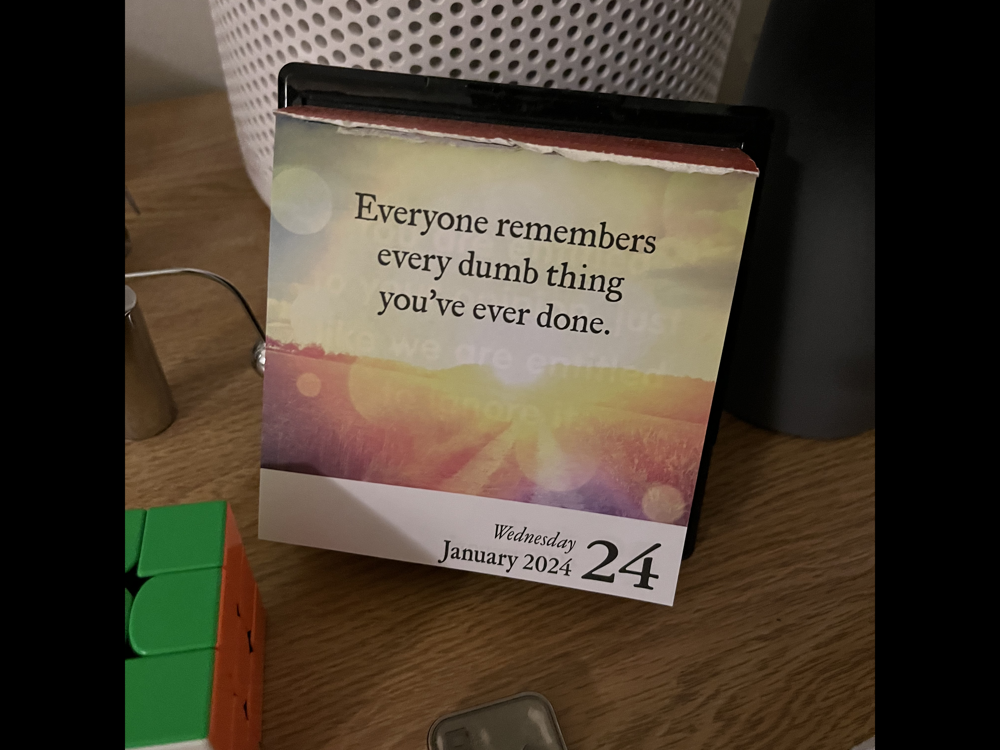

Image 2:


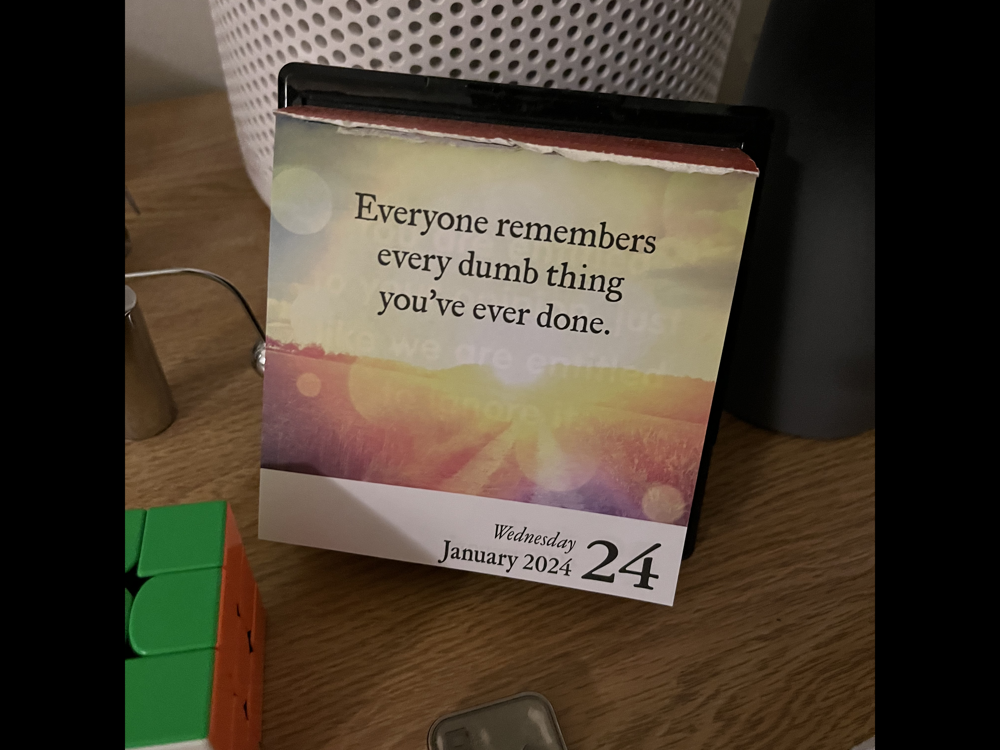

KeyboardInterrupt: Interrupted by user

In [12]:
# Run the tournament
run_tournament(image_folder, next_round_folder)